# Limpieza de bienes raíces

Este es un conjunto de datos (dataset) reales que fue descargado usando técnicas de web scraping. La data contiene registros de **Fotocasa**, el cual es uno de los sitios más populares de bienes raíces en España. Por favor no hagas esto (web scraping) a no ser que sea para propósitos académicos.

El dataset fue descargado hace algunos años por Henry Navarro y en ningún caso se obtuvo beneficio económico de ello.

Contiene miles de datos de casas reales publicadas en la web www.fotocasa.com. Tu objetivo es extraer tanta información como sea posible con el conocimiento que tienes hasta ahora de ciencia de datos, por ejemplo ¿cuál es la casa más cara en todo el dataset?

Empecemos precisamente con esa pregunta... ¡Buena suerte!

#### Ejercicio 00. Lee el dataset assets/real_estate.csv e intenta visualizar la tabla (★☆☆)

In [1]:
import pandas as pd

# Este archivo CSV contiene puntos y comas en lugar de comas como separadores
ds = pd.read_csv('assets/real_estate.csv', sep=';')
ds

,Unnamed: 0,id_realEstates,isNew,realEstate_name,phone_realEstate,url_inmueble,rooms,bathrooms,surface,price,...,level4Id,level5Id,level6Id,level7Id,level8Id,accuracy,latitude,longitude,zipCode,customZone
0,1,153771986,False,ferrari 57 inmobiliaria,912177526.0,https://www.fotocasa.es/es/comprar/vivienda/ma...,3.0,2.0,103.0,195000,...,0,0,0,0,0,0,"40,2948276786438","-3,44402412135624",NaN,NaN
1,2,153867863,False,tecnocasa fuenlabrada ferrocarril,916358736.0,https://www.fotocasa.es/es/comprar/vivienda/ma...,3.0,1.0,NaN,89000,...,0,0,0,0,0,1,"40,28674","-3,79351",NaN,NaN
2,3,153430440,False,look find boadilla,916350408.0,https://www.fotocasa.es/es/comprar/vivienda/ma...,2.0,2.0,99.0,390000,...,0,0,0,0,0,0,"40,4115646786438","-3,90662252135624",NaN,NaN
3,4,152776331,False,tecnocasa fuenlabrada ferrocarril,916358736.0,https://www.fotocasa.es/es/comprar/vivienda/ma...,3.0,1.0,86.0,89000,...,0,0,0,0,0,0,"40,2853785786438","-3,79508142135624",NaN,NaN
4,5,153180188,False,ferrari 57 inmobiliaria,912177526.0,https://www.fotocasa.es/es/comprar/vivienda/ma...,2.0,2.0,106.0,172000,...,0,0,0,0,0,0,"40,2998774864376","-3,45226301356237",NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15330,15331,153901377,False,infocasa consulting,911360461.0,https://www.fotocasa.es/es/comprar/vivienda/ma...,2.0,1.0,96.0,259470,...,0,0,0,0,0,0,"40,45416","-3,70286",NaN,NaN
15331,15332,150394373,False,inmobiliaria pulpon,912788039.0,https://www.fotocasa.es/es/comprar/vivienda/ma...,3.0,1.0,150.0,165000,...,0,0,0,0,0,0,"40,36652","-3,48951",NaN,NaN
15332,15333,153901397,False,tecnocasa torrelodones,912780348.0,https://www.fotocasa.es/es/comprar/vivienda/ma...,4.0,2.0,175.0,495000,...,0,0,0,0,0,0,"40,57444","-3,92124",NaN,NaN
15333,15334,152607440,False,inmobiliaria pulpon,912788039.0,https://www.fotocasa.es/es/comprar/vivienda/ma...,3.0,2.0,101.0,195000,...,0,0,0,0,0,0,"40,36967","-3,48105",NaN,NaN


#### Ejercicio 01. ¿Cuál es la casa más cara en todo el dataset? (★☆☆)

Imprime la dirección y el precio de la casa seleccionada. Por ejemplo:

`La casa con dirección en Calle del Prado, Nº20 es la más cara y su precio es de 5000000 USD`

In [2]:
# Se debe encontrar el índice correspondiente a la casa más cara, esto es el elemento cuyo valor en la columna "price" es el más alto:
max_price_index = ds["price"].idxmax();

# Se busca el precio de la casa que tiene dicho índice:
max_price = ds.loc[max_price_index, "price"];

# Se busca la dirección de la casa que tiene dicho índice:
max_price_address = ds.loc[max_price_index, "address"];

# Se imprime la frase:
print (f"La casa con dirección en {max_price_address} es la más cara y su precio es de {max_price} USD");


La casa con dirección en El Escorial es la más cara y su precio es de 8500000 USD


#### Ejercicio 02. ¿Cuál es la casa más barata del dataset? (★☆☆)

Imprime la dirección y el precio de la casa seleccionada. Por ejemplo:

`La casa con dirección en Calle Alcalá, Nº58 es la más barata y su precio es de 12000 USD`

In [3]:
# Se debe encontrar el índice correspondiente a la casa más barata, esto es el elemento cuyo valor en la columna "price" es el más bajo:
min_price_index = ds["price"].idxmin();

# Se busca el precio de la casa que tiene dicho índice:
min_price = ds.loc[min_price_index, "price"];

# Se busca la dirección de la casa que tiene dicho índice:
min_price_address = ds.loc[min_price_index, "address"];

# Se imprime la frase:
print (f"La casa con dirección en {min_price_address} es la más barata y su precio es de {min_price} USD");

# Si queremos descartar las casas cuyo precio sea 0 USD, se debe complicar un poco más el código:
# Primero, se han de guardar los previos en un array:
prices = ds["price"].values;

# Se debe encontrar el mínimo precio, descartando aquellos cuyo valor es 0, y el índice del DataFrame donde se puede encontrar:
min_price = prices [0];
min_price_index = 0;

for i in range (0, len(prices), 1):
    if prices [i] <= min_price and prices[i]!=0:
        min_price = prices [i];
        min_price_index = i;


# Se busca la dirección de la casa con dicho índice:
min_price_address = ds.loc[min_price_index, "address"];

# Se imprime la frase:
print (f"La casa con dirección en {min_price_address} es la más barata y su precio es de {min_price} USD");

La casa con dirección en Parla es la más barata y su precio es de 0 USD
La casa con dirección en Berlin, Coslada es la más barata y su precio es de 600 USD


#### Ejercicio 03. ¿Cuál es la casa más grande y la más pequeña del dataset? (★☆☆)

Imprime la dirección y el área de las casas seleccionadas. Por ejemplo:

`La casa más grande está ubicada en Calle Gran Vía, Nº38 y su superficie es de 5000 metros`

`La casa más pequeña está ubicada en Calle Mayor, Nº12 y su superficie es de 200 metros`

In [4]:
# Se debe encontrar el índice correspondiente a la casa más grande, esto es el elemento cuyo valor en la columna "surface" es el más alto:
max_surface_index = ds["surface"].idxmax();

# Se busca la superficie de la casa que tiene dicho índice:
max_surface = ds.loc[max_surface_index, "surface"];

# Se busca la dirección de la casa con dicho índice:
max_surface_address = ds.loc[max_surface_index, "address"];

# Se imprime la frase:
print (f"La casa más grande está ubicada en {max_surface_address} y su superficie es de {max_surface} m");


# Se debe encontrar el índice correspondiente a la casa más pequeña, esto es el elemento cuyo valor en la columna "surface" es el más bajo:
min_surface_index = ds["surface"].idxmin();

# Se busca la superficie de la casa con dicho índice:
min_surface = ds.loc[min_surface_index, "surface"];

# Se busca la dirección de la casa con dicho índice:
min_surface_address = ds.loc[min_surface_index, "address"];

# Se imprime la frase:
print (f"La casa más pequeña está ubicada en {min_surface_address} y su superficie es de {min_surface} m");


La casa más grande está ubicada en Sevilla la Nueva y su superficie es de 249000.0 m
La casa más pequeña está ubicada en Calle Amparo,  Madrid Capital y su superficie es de 15.0 m


#### Ejercicio 04. ¿Cuantas poblaciones (columna level5) contiene el dataset? (★☆☆)

Imprime el nombre de las poblaciones separadas por coma. Por ejemplo:

`> print(populations)`

`population1, population2, population3, ...`

In [5]:
# La librería "Pandas" contiene una función llamada "drop_duplicates()" que elimina los items duplicados de una columna dada:
populations = ds["level5"].drop_duplicates();

# Ahora que se tienen todas las poblaciones, sin repetir, en un array, se puede calcular su longitud:
number_populations = len(populations);
print (f"Hay {number_populations} poblaciones distintas en el DataSet:");

# Para poder imprimir las poblaciones, sin que haya saltos de línea, utilizamos la función .join(), añadiendo que el separador se desea que sea una "coma"
print(', '.join(populations));


Hay 168 poblaciones distintas en el DataSet:
Arganda del Rey, Fuenlabrada, Boadilla del Monte, Las Rozas de Madrid,  Madrid Capital, Villaviciosa de Odón, Pinto, Valdemoro, Navalcarnero, Pozuelo de Alarcón, Torrejón de Ardoz, Navalagamella, San Sebastián de los Reyes, Rivas-vaciamadrid, Alpedrete, Móstoles, San Fernando de Henares, Coslada, Becerril de la Sierra, Alcalá de Henares, Chinchón, Parla, Alcorcón, El Escorial, Leganés, Pedrezuela, Majadahonda, Villanueva de la Cañada, Villanueva del Pardillo, Torrelodones, Moralzarzal, Mejorada del Campo, Aranjuez, Corpa, Getafe, Velilla de San Antonio, Sevilla la Nueva, San Martín de la Vega, Villalbilla, Collado Villalba, Alcobendas, El Molar (Madrid), Moraleja de Enmedio, Algete, Campo Real, Torrejón de la Calzada, Colmenar Viejo, Valdemorillo, Fuente El Saz de Jarama, Tres Cantos, Arroyomolinos (Madrid), Griñón, Paracuellos de Jarama, Guadarrama, Titulcia, Galapagar, Collado Mediano, Los Molinos, San Lorenzo de El Escorial, Loeches, San 

#### Ejercicio 05. ¿El dataset contiene valores no admitidos (NAs)? (★☆☆)

Imprima un booleano (`True` o `False`) seguido de la fila/columna que contiene el NAs.

In [6]:
# Se debe recorrer todo el Data Set para analizar item por item si hay un valor no admitido
# Esto implica recorrer en cada fila, todos los elementos, columna por columna y comprobar si dicho elemento es un NA:

# Se itera para todas las filas:
for row in range(len(ds)):
    # Se itera para cada fila, por columna: 
    for column in ds.columns:
        # Se comprueba si el valor del Data Set en ese punto [fila, columna] es NA:
        if pd.isnull(ds.loc[row, column]):
            print(f"Fila {row}, Columna {column}: True");
        else:
            print(f"Fila {row}, Columna {column}: False");

Fila 0, Columna Unnamed: 0: False
Fila 0, Columna id_realEstates: False
Fila 0, Columna isNew: False
Fila 0, Columna realEstate_name: False
Fila 0, Columna phone_realEstate: False
Fila 0, Columna url_inmueble: False
Fila 0, Columna rooms: False
Fila 0, Columna bathrooms: False
Fila 0, Columna surface: False
Fila 0, Columna price: False
Fila 0, Columna date: False
Fila 0, Columna description: False
Fila 0, Columna address: False
Fila 0, Columna country: False
Fila 0, Columna level1: False
Fila 0, Columna level2: False
Fila 0, Columna level3: False
Fila 0, Columna level4: False
Fila 0, Columna level5: False
Fila 0, Columna level6: True
Fila 0, Columna level7: False
Fila 0, Columna level8: True
Fila 0, Columna upperLevel: False
Fila 0, Columna countryId: False
Fila 0, Columna level1Id: False
Fila 0, Columna level2Id: False
Fila 0, Columna level3Id: False
Fila 0, Columna level4Id: False
Fila 0, Columna level5Id: False
Fila 0, Columna level6Id: False
Fila 0, Columna level7Id: False
Fila 0, 

Fila 2894, Columna level6Id: False
Fila 2894, Columna level7Id: False
Fila 2894, Columna level8Id: False
Fila 2894, Columna accuracy: False
Fila 2894, Columna latitude: False
Fila 2894, Columna longitude: False
Fila 2894, Columna zipCode: True
Fila 2894, Columna customZone: True
Fila 2895, Columna Unnamed: 0: False
Fila 2895, Columna id_realEstates: False
Fila 2895, Columna isNew: False
Fila 2895, Columna realEstate_name: False
Fila 2895, Columna phone_realEstate: False
Fila 2895, Columna url_inmueble: False
Fila 2895, Columna rooms: False
Fila 2895, Columna bathrooms: False
Fila 2895, Columna surface: False
Fila 2895, Columna price: False
Fila 2895, Columna date: False
Fila 2895, Columna description: False
Fila 2895, Columna address: False
Fila 2895, Columna country: False
Fila 2895, Columna level1: False
Fila 2895, Columna level2: False
Fila 2895, Columna level3: False
Fila 2895, Columna level4: False
Fila 2895, Columna level5: False
Fila 2895, Columna level6: True
Fila 2895, Columna

#### Ejercicio 06. Elimina los NAs del dataset, si aplica (★★☆)

Imprima una comparación entre las dimensiones del DataFrame original versus el DataFrame después de las eliminaciones.


In [7]:
# Se guarda el tamaño (fila x columna) del Data Set antes de cambiarlo:
before_size = ds.shape;

# Se va a utilizar el mismo for loop encadenado que para el ejercicio anterior
# De esta forma, cuando se detecte que un elemento es NA, se guarda su "posición" [fila, columna] para, posteriormente, eliminar dichas filas/columnas

# Array para guardar el número de fila donde se ha detectado un NA:
rows_delete = [];

# Array para guardar el número de columna donde se ha detectado un NA:
columns_delete = [];

# Se itera para todas las filas:
for row in range(len(ds)):
    # Se itera para cada fila, por columna: 
    for column in ds.columns:
        # Se comprueba si el valor del Data Set en ese punto [fila, columna] es NA:
        if pd.isnull(ds.loc[row, column]):
            # Se agrega el número de fila al array de filas a eliminar:
            rows_delete.append(row);
            # Se agrega el número de columna al array de columnas a eliminar:
            columns_delete.append(column);

# Para eliminar las filas y columnas con NA se va a utilizar la función .drop()
# Primero, se eliminan las filas con NA pasando a la función .drop(), los números de filas donde se ha detectado un NA:
ds_noNa = ds.drop(index=rows_delete);

# Se coge el Data Set con las filas eliminadas, y se procede a usar de nuevo .drop() pasando los números de columna donde se ha detectado un NA:
ds_noNa = ds_noNa.drop(columns=columns_delete);

# Se guarda el tamaño (fila x columna) del Data Set después de cambiarlo:
after_size = ds_noNa.shape

# Se imprimen los resultados
print("Tamaño antes de eliminar los datos No Admitidos (NAs):", before_size)
print("Tamaño después de eliminar los datos No Admitidos (NAs):", after_size)

Tamaño antes de eliminar los datos No Admitidos (NAs): (15335, 37)
Tamaño después de eliminar los datos No Admitidos (NAs): (0, 25)


#### Ejercicio 07. ¿Cuál la media de precios en la población (columna level5) de "Arroyomolinos (Madrid)"? (★★☆)

Imprima el valor obtenido.

In [18]:
# Se guarda en un nuevo DataFrame solo la información de la población de "Arroyomolinos (Madrid)", es decir, se guardan las filas donde level5 = Arroyomolinos (Madrid) es True:
selected_population_Arroyomolinos = ds[ds['level5']== "Arroyomolinos (Madrid)"];

# Se selecciona solo la información relativa a la columna "price" y se realiza la media de los datos:
mean_price_Arroyomolinos = selected_population_Arroyomolinos ['price'].mean();

# Se impirme el valor medio de precios obtenidos:
print (f" El precio medio de las viviendas de Arroyomolinos (Madrid) es {mean_price_Arroyomolinos.round()} USD.");

 El precio medio de las viviendas de Arroyomolinos (Madrid) es 294542.0 USD.


#### Ejercicio 08. Trazar el histograma de los precios para la población (level5 column) de "Arroyomolinos (Madrid)" y explica qué observas (★★☆)

Imprime el histograma de los precios y escribe en la celda del Markdown un breve análisis del trazado.


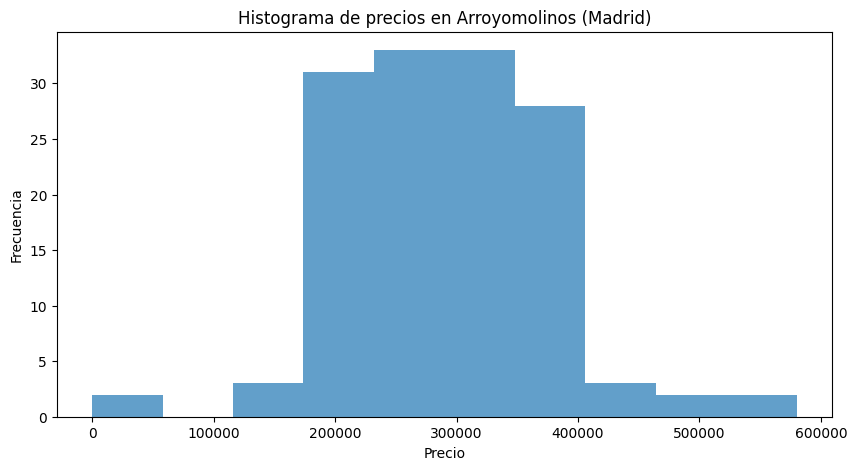

In [9]:
# Se importa la librería matplotlib.pyplot para poder trazar histogramas:
import matplotlib.pyplot as plt

# Se utiliza el Data Set creado en el ejercicio anterior, solo con la informacion de "Arroyomolinos (Madrid)"
# Se guardan en un array todos los datos de la columna "price" para poder utilizarlos en el histograma:
price_selected_population = selected_population_Arroyomolinos ['price'];

# Se traza el histograma:
plt.figure(figsize = (10, 5));
plt.hist(price_selected_population, bins=10, alpha = 0.7);
plt.title("Histograma de precios en Arroyomolinos (Madrid)");
plt.xlabel("Precio");
plt.ylabel("Frecuencia")
plt.show()


- El histograma trazado representa cómo se distribuyen los precios de la población "Arroyomolinos (Madrid)".

- Dado el gráfico, se puede observar que los precios en esta localidad se concentran en la franja entre los 200.000 USD y los 400.000 USD, siendo alrededor de los 300.000 USD donde se encuentra el precio para la mayoría de las viviendas de Arroyomolinos. 

- En esta población no parece haber precios extremos, al no tener mucha recurrencia de precios por encima de los 400.000 USD, no llegando para ningún dato registrado a los 600.000 USD. 

- Por otro lado, se pueden observar datos aislados, cerca de los 0 USD. Estos parecen ser valores atípicos, y poco representativos, que pueden deberse a falta de información o errores en el registro de algunas viviendas del Data Set.

#### Ejercicio 09. ¿Son los precios promedios de "Valdemorillo" y "Galapagar" los mismos? (★★☆)

Imprime ambos promedios y escribe una conclusión sobre ellos.

In [19]:
# Se realizan exactamente los mismos pasos que en el Ejercicio 07 pero con las poblaciones de "Valdemorillo" y "Galapagar":

# Se guarda en un nuevo DataFrame solo la información de la población de "Valdemorillo" y con la información de "Galapagar":
selected_population_Valdemorillo = ds[ds['level5']== "Valdemorillo"];
selected_population_Galapagar= ds[ds['level5']== "Galapagar"];

# Se selecciona solo la información relativa a la columna "price" y se realiza la media de los datos de "Valdemorillo" y "Galapagar":
mean_price_Valdemorillo = selected_population_Valdemorillo ['price'].mean();
mean_price_Galapagar = selected_population_Galapagar ['price'].mean();

# Se impirme el valor medio de precios obtenidos:
print (f" El precio medio de las viviendas de Valdemorillo es {mean_price_Valdemorillo.round()} USD.");
print (f" El precio medio de las viviendas de Galapagar es {mean_price_Galapagar.round()} USD.");

# Para poder realizar la comparación con más detalle, se imprime la diferencia de precios promedio entre Galapagar y Valdemorillo:
print (f" La diferencia de precio entre las viviendas de Galapagar y de Valdemorillo es de {abs(mean_price_Valdemorillo - mean_price_Galapagar).round()} USD");

# Para poder tener una referencia con respecto a otras poblaciones, usamos el precio promedio de Arroyomolinos:
print (f" La diferencia de precio entre las viviendas de Arroyomolinos y de Valdemorillo es de {abs(mean_price_Valdemorillo - mean_price_Arroyomolinos).round()} USD");

 El precio medio de las viviendas de Valdemorillo es 363860.0 USD.
 El precio medio de las viviendas de Galapagar es 360063.0 USD.
 La diferencia de precio entre las viviendas de Galapagar y de Valdemorillo es de 3797.0 USD
 La diferencia de precio entre las viviendas de Arroyomolinos y de Valdemorillo es de 69319.0 USD


- Galapagar y Valdemorillo son dos poblaciones relativamente cercanas en el Noroeste de la Comunidad de Madrid, lo que podría llevar a pensar que los precios promedio deberían similares, tal y como se ha comprobado.

- Dados los resultados, se puede observar que la diferencia entre ambos precios promedio es de casi 4.000 USD, bastante inferior a la diferencia entre, por ejemplo, las poblaciones de Valdemorillo y Arroyomolinos que es de casi 70.000 USD (dos localidades bastante alejadas dentro de la Comunidad de Madrid).

- A la luz de estos datos se puede deducir que el precio/m2 es coherente y está relacionado con la zona en la que se encuentran las viviendas, dado que poblaciones cercanas en distancia tienen precios similares.

#### Ejercicio 10. ¿Son los promedios de precio por metro cuadrado (precio/m2) de "Valdemorillo" y "Galapagar" los mismos? (★★☆)

Imprime ambos promedios de precio por metro cuadrado y escribe una conclusión sobre ellos.

Pista: Crea una nueva columna llamada `pps` (*price per square* o precio por metro cuadrado) y luego analiza los valores.

In [22]:
# Se crea la nueva columna en el Data Set, resultante de la división de los datos de 'price' / 'surface' (USD/m2)
ds ['pps'] = ds['price'] / ds['surface'];

# Se utilizan los Data Sets creados en el Ejercicio anterior que solo contienen información de la población de "Valdemorillo" y con la información de "Galapagar":
# Se selecciona solo la información relativa a la columna "price" y se realiza la media de los datos de "Valdemorillo" y "Galapagar":
mean_pps_Valdemorillo = selected_population_Valdemorillo ['pps'].mean();
mean_pps_Galapagar = selected_population_Galapagar ['pps'].mean();

# Se impirme el valor medio de precios/m2 obtenidos:
print (f" El precio/m2 medio de las viviendas de Valdemorillo es {mean_pps_Valdemorillo.round()} USD.");
print (f" El precio/m2 medio de las viviendas de Galapagar es {mean_pps_Galapagar.round()} USD.");

# Para poder realizar la comparación con más detalle, se imprime la diferencia de precios promedio entre Galapagar y Valdemorillo:
print (f" La diferencia de precio/m2 entre las viviendas de Galapagar y de Valdemorillo es de {abs(mean_pps_Valdemorillo - mean_pps_Galapagar).round()} USD");


 El precio/m2 medio de las viviendas de Valdemorillo es 1318.0 USD.
 El precio/m2 medio de las viviendas de Galapagar es 1606.0 USD.
 La diferencia de precio/m2 entre las viviendas de Galapagar y de Valdemorillo es de 288.0 USD


- Al igual que ha ocurrido con la comparación de precios medios entre Valdemorillo y Galapagar, el precio/m2 también es muy similar en estas dos poblaciones, variando a penas 300€/m2.


#### Ejercicio 11. Analiza la relación entre la superficie y el precio de las casas. (★★☆)

Pista: Puedes hacer un `scatter plot` y luego escribir una conclusión al respecto.

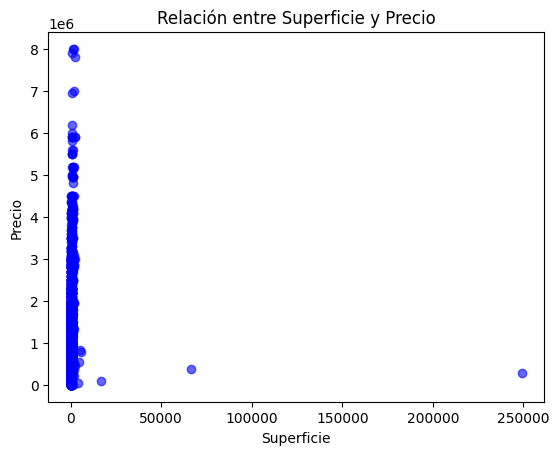

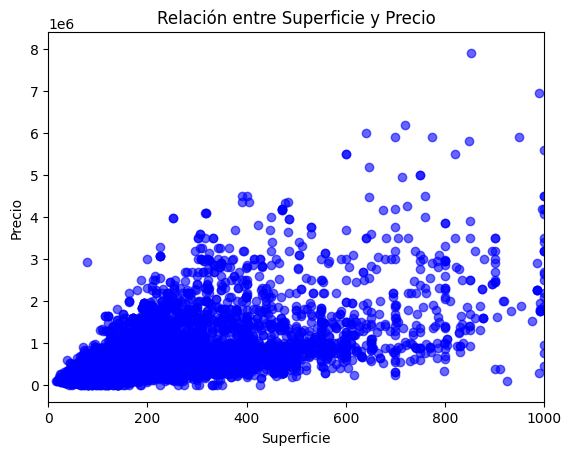

In [ ]:
# TODO: Código

surface = ds['surface'];
prices = ds['price'];

plt.scatter(surface, prices, color='blue', alpha=0.6)
plt.title("Relación entre Superficie y Precio")
plt.xlabel("Superficie")
plt.ylabel("Precio")
plt.show()

surface_selected = ds['surface'];
prices_selected = ds['price'];

plt.scatter(surface, prices, color='blue', alpha=0.6)
plt.title("Relación entre Superficie y Precio")
plt.xlabel("Superficie")
plt.ylabel("Precio")
plt.xlim(0, 1000) 
plt.show()

**TODO: Markdown**. Para escribir aquí, haz doble clic en esta celda, elimina este contenido y coloca lo que quieras escribir. Luego ejecuta la celda.

#### Ejercicio 12. ¿Cuántas agencia de bienes raíces contiene el dataset? (★★☆)

Imprime el valor obtenido.

In [ ]:
# TODO
# The library "Pandas" contains a function called "drop_duplicates()" that deletes the duplicated items of a given column:
# La librería "Pandas" contiene una función llamada "drop_duplicates()" que elimina los items duplicados de una columna dada:
realEstate = ds["realEstate_name"].drop_duplicates();

# Now that we only have in column "level5" unrepeated populations, we can compute the length of it
number_realEstate = len(realEstate);
print (f"Hay {number_realEstate} agencias distintas en el DataSet");

Hay 1822 agencias distintas en el DataSet


#### Ejercicio 13. ¿Cuál es la población (columna level5) que contiene la mayor cantidad de casas?(★★☆)

Imprima la población y el número de casas.

In [ ]:
# TODO
# Cogemos el dataFrame donde habíamos quitado los duplicados:
ranking_populations = ds['level5'].value_counts()
print (ranking_populations);

first_population = ranking_populations.index[0]
number_houses = ranking_populations.iloc[0]

print(f"La población con más casas es {first_population} con {number_houses} casas.")

level5
 Madrid Capital         6643
Alcalá de Henares        525
Las Rozas de Madrid      383
Móstoles                 325
Getafe                   290
                        ... 
Fresno de Torote           1
Pinilla del Valle          1
Rascafría                  1
La Hiruela                 1
Montejo de la Sierra       1
Name: count, Length: 168, dtype: int64
La población con más casas es  Madrid Capital con 6643 casas.


#### Ejercicio 14. Ahora vamos a trabajar con el "cinturón sur" de Madrid. Haz un subconjunto del DataFrame original que contenga las siguientes poblaciones (columna level5): "Fuenlabrada", "Leganés", "Getafe", "Alcorcón" (★★☆)

Pista: Filtra el DataFrame original usando la columna `level5` y la función `isin`.

In [ ]:
# TODO
# Lista de poblaciones que quieres seleccionar
selected_populations = ['Fuenlabrada', 'Leganés', 'Getafe', 'Alcorcón']

# Crear el subconjunto del DataFrame usando la función isin()
new_ds = ds[ds['level5'].isin(selected_populations)]


#### Ejercicio 15. Traza un gráfico de barras de la mediana de los precios y explica lo que observas (debes usar el subconjunto obtenido del Ejercicio 14) (★★★)

Imprima un gráfico de barras de la mediana de precios y escriba en la celda Markdown un breve análisis sobre el gráfico.

Text(0, 0.5, 'Mediana del Precio')

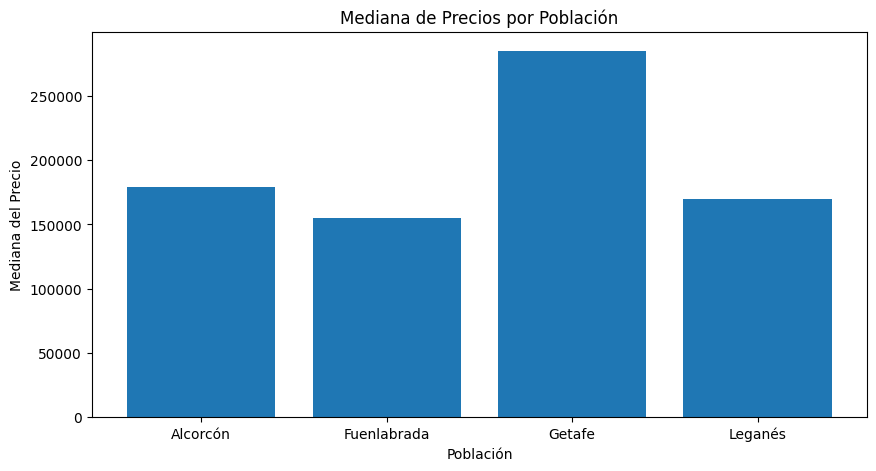

In [ ]:
# TODO: Code
prices = new_ds.groupby('level5')['price'];
median_prices = prices.median();
indexes_prices = median_prices.index;

plt.figure(figsize = (10, 5))

plt.bar(indexes_prices, median_prices)
plt.title("Mediana de Precios por Población")
plt.xlabel("Población")
plt.ylabel("Mediana del Precio")

**TODO: Markdown**. Para escribir aquí, haz doble clic en esta celda, elimina este contenido y coloca lo que quieras escribir. Luego ejecuta la celda.

#### Ejercicio 16. Calcula la media y la varianza de muestra para las siguientes variables: precio, habitaciones, superficie y baños (debes usar el subconjunto obtenido del Ejercicio 14) (★★★)

Imprime ambos valores por cada variable.

In [ ]:
# TODO
def cal_mean_var (variable):
    mean = new_ds[variable].mean().round();
    var = new_ds[variable].var().round();
    print (f"La media de la variable {variable} es {mean} y la varianza es {var}");
    return

cal_mean_var('price');
cal_mean_var('rooms');
cal_mean_var('surface');
cal_mean_var('bathrooms');


La media de la variable price es 223094.0 y la varianza es 14921367508.0
La media de la variable rooms es 3.0 y la varianza es 1.0
La media de la variable surface es 112.0 y la varianza es 4263.0
La media de la variable bathrooms es 2.0 y la varianza es 1.0


#### Ejercicio 17. ¿Cuál es la casa más cara de cada población? Debes usar el subset obtenido en la pregunta 14 (★★☆)

Imprime tanto la dirección como el precio de la casa seleccionada de cada población. Puedes imprimir un DataFrame o una sola línea para cada población.

In [ ]:
# TODO

ds_Alcorcon = new_ds[new_ds['level5'] == "Alcorcón"];
ds_Fuenlabrada = new_ds[new_ds['level5'] == "Fuenlabrada"];
ds_Getafe = new_ds[new_ds['level5']== "Getafe"];
ds_Leganes = new_ds[new_ds['level5']== "Leganés"];


def cal_price (ds):
    # We need to find the index of the most expensive house, this is the element whose value in the column "price" in the highest:
    # Se debe encontrar el índice correspondiente a la casa más cara, esto es el elemento cuyo valor en la columna "price" es el más alto:
    max_price_index = ds["price"].idxmax();

    # We look for the price of the house with that index:
    # Se busca el precio de la casa que tiene dicho índice:
    max_price = ds.loc[max_price_index, "price"];

    # We look for the address of the house with that index: 
    # Se busca la dirección de la casa que tiene dicho índice:
    max_price_address = ds.loc[max_price_index, "address"];

    population = ds.loc[max_price_index, "level5"];

    # We print the statement: 
    # Se imprime la frase:
    print (f"La casa de {population} con dirección en {max_price_address} es la más cara y su precio es de {max_price} USD");
    return


cal_price (ds_Alcorcon);
cal_price (ds_Fuenlabrada);
cal_price (ds_Getafe);
cal_price (ds_Leganes);



La casa de Alcorcón con dirección en Alcorcón es la más cara y su precio es de 950000 USD
La casa de Fuenlabrada con dirección en Calle de Paulo Freire, 5, Fuenlabrada es la más cara y su precio es de 490000 USD
La casa de Getafe con dirección en Getafe es la más cara y su precio es de 1050000 USD
La casa de Leganés con dirección en Avenida Reina Sofía, Leganés es la más cara y su precio es de 650000 USD


#### Ejercicio 18. Normaliza la variable de precios para cada población y traza los 4 histogramas en el mismo gráfico (debes usar el subconjunto obtenido en la pregunta 14) (★★★)

Para el método de normalización, puedes usar el que consideres adecuado, no hay una única respuesta correcta para esta pregunta. Imprime el gráfico y escribe en la celda de Markdown un breve análisis sobre el gráfico.

Pista: Puedes ayudarte revisando la demostración multihist de Matplotlib.

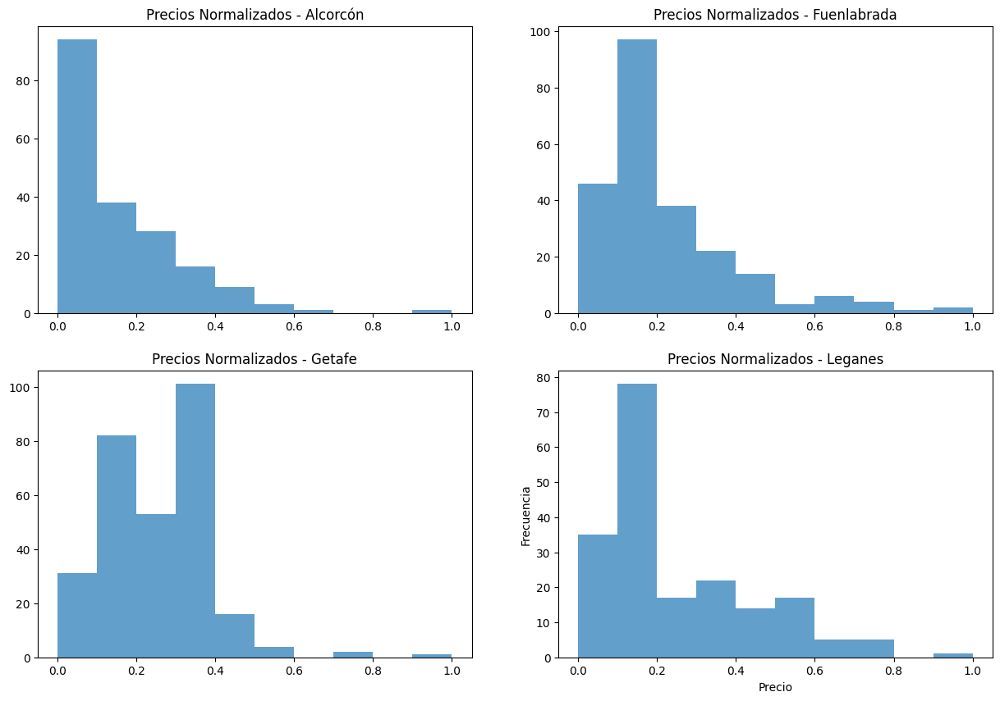

In [ ]:
# TODO

def normalization (ds):
    min_price = ds['price'].min()
    max_price = ds['price'].max()
    normalized_prices = (ds['price'] - min_price) / (max_price - min_price);
    return normalized_prices;

normalized_Alcorcon = normalization (ds_Alcorcon);
normalized_Fuenlabrada = normalization (ds_Fuenlabrada);
normalized_Getafe = normalization (ds_Getafe);
normalized_Leganes = normalization (ds_Leganes);

plt.figure(figsize = (15, 10))

plt.subplot(2, 2, 1) 
plt.hist(normalized_Alcorcon, bins=10, alpha = 0.7)
plt.title("Precios Normalizados - Alcorcón")

plt.subplot(2, 2, 2) 
plt.hist(normalized_Fuenlabrada, bins=10, alpha = 0.7)
plt.title("Precios Normalizados - Fuenlabrada")

plt.subplot(2, 2, 3) 
plt.hist(normalized_Getafe, bins=10, alpha = 0.7)
plt.title("Precios Normalizados - Getafe")

plt.subplot(2, 2, 4) 
plt.hist(normalized_Leganes, bins=10, alpha = 0.7)
plt.title("Precios Normalizados - Leganes")

plt.xlabel("Precio")
plt.ylabel("Frecuencia")
plt.show()



**TODO: Markdown**. Para escribir aquí, haz doble clic en esta celda, elimina este contenido y coloca lo que quieras escribir. Luego ejecuta la celda.

#### Ejercicio 19. ¿Qué puedes decir sobre el precio por metro cuadrado (precio/m2) entre los municipios de 'Getafe' y 'Alcorcón'? Debes usar el subconjunto obtenido en la pregunta 14 (★★☆)

Pista: Crea una nueva columna llamada `pps` (price per square en inglés) y luego analiza los valores

/tmp/ipykernel_39890/3790708701.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  new_ds ['pps'] = new_ds['price'] / new_ds['surface'];


Text(0, 0.5, 'Media del Precio')

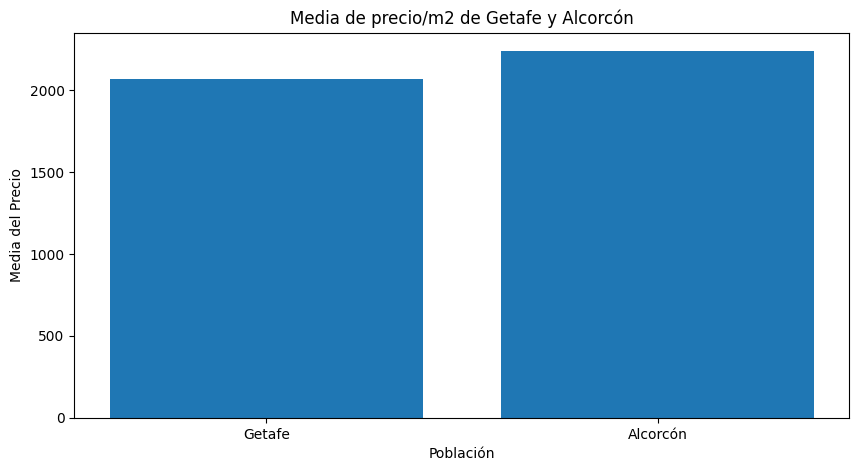

In [ ]:
# TODO

# Cogemos el DataSet con únicamente las 4 poblaciones (new_ds) y creamos una nueva columna:
#new_ds.loc [:, 'pps'] = new_ds ['price'] / new_ds ['surface'];
new_ds ['pps'] = new_ds['price'] / new_ds['surface'];

ds_Getafe = new_ds[new_ds['level5'] == 'Getafe'];
price_Getafe = ds_Getafe['pps'].mean();

ds_Alcorcon = new_ds[new_ds['level5'] == 'Alcorcón'];
price_Alcorcon = ds_Alcorcon['pps'].mean();

indexes_prices = ["Getafe", "Alcorcón"];
indexes_populations = [price_Getafe, price_Alcorcon];

plt.figure(figsize = (10, 5))

plt.bar(indexes_prices, indexes_populations)
plt.title("Media de precio/m2 de Getafe y Alcorcón")
plt.xlabel("Población")
plt.ylabel("Media del Precio")


#### Ejercicio 20. Realiza el mismo gráfico para 4 poblaciones diferentes (columna level5) y colócalos en el mismo gráfico. Debes usar el subconjunto obtenido en la pregunta 14 (★★☆) 
Pista: Haz un diagrama de dispersión de cada población usando subgráficos (subplots).

Text(0, 0.5, 'Media del Precio')

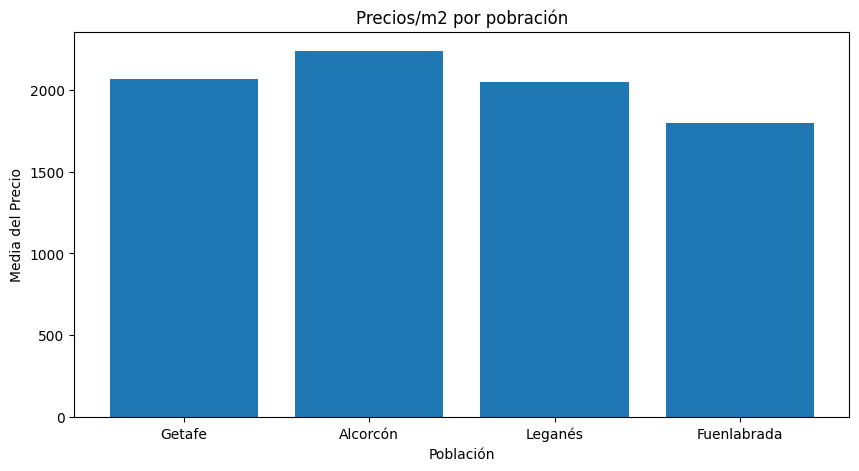

In [ ]:
# TODO
ds_Leganes = new_ds[new_ds['level5'] == 'Leganés'];
price_Leganes = ds_Leganes['pps'].mean();

ds_Fuenlabrada = new_ds[new_ds['level5'] == 'Fuenlabrada'];
price_Fuenlabrada = ds_Fuenlabrada['pps'].mean();

indexes_prices = ["Getafe", "Alcorcón", "Leganés", "Fuenlabrada"];
indexes_populations = [price_Getafe, price_Alcorcon, price_Leganes, price_Fuenlabrada];

plt.figure(figsize = (10, 5))

plt.bar(indexes_prices, indexes_populations)
plt.title("Precios/m2 por pobración")
plt.xlabel("Población")
plt.ylabel("Media del Precio")

#### Ejercicio 21. Realiza un trazado de las coordenadas (columnas latitud y longitud) del cinturón sur de Madrid por color de cada población (debes usar el subconjunto obtenido del Ejercicio 14) (★★★★)

Ejecuta la siguiente celda y luego comienza a codear en la siguiente. Debes implementar un código simple que transforme las columnas de coordenadas en un diccionario de Python (agrega más información si es necesario) y agrégala al mapa.

In [ ]:
from ipyleaflet import Map, basemaps

# Mapa centrado en (60 grados latitud y -2.2 grados longitud)
# Latitud, longitud
map = Map(center = (60, -2.2), zoom = 2, min_zoom = 1, max_zoom = 20, 
    basemap=basemaps.Stamen.Terrain)
map

AttributeError: Stamen

In [ ]:
## Aquí: traza la coordenadas de los estados

## PON TU CÓDIGO AQUÍ:
